## The Z-Transform and STFT

Short-Time Fourier Transform

In this part, you will be implementing the short-time Fourier transform (STFT) and instantaneous frequency to change the pitch of audio files. Use the same audio clips as we had in HW 2: (winniethepooh.wav) and (bach.wav), available from the class webpage.


## Question 1:

Write a Python function to compute the short-time Fourier transform (STFT) of a signal.
Your function should take the following inputs: a signal x[n], a window, w[n], and the hop
length, h. It should output the STFT X[k, m]. Note: the length of your Fourier transform
will be determined by the length of the w[n] array.


## Answer:

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import wave
from IPython.display import Audio

def STFT(x, w, h):
    N = len(x)  # Length of the input signal
    L = len(w)  # Length of the window function
    H = ((N - L) // h) + 1  # Calculate the number of hops
    #print(N,L,H)
    #print(H)
    X = np.zeros(((L//2+1),H), dtype=np.complex128) # Initialize output STFT matrix
    
    for m in range(H):
        x_clip = x[m*h : m*h + L]  # Extract the current frame from the input signal
        X[:, m] = np.fft.rfft(x_clip * w)
    #print(X.shape)
    return X


## Question 2:

Write a Python function implementing the overlap-add (OLA) method to synthesize a signal
from its STFT. Your function should take the following inputs: an STFT, X[k, m], a window,
w[n], and the hop length, h. It should output the synthesized signal, x[n].

## Answer:

In [38]:
def OLA(X, w, h):
    rows = X.shape[0]
    columns = X.shape[1]
    H = columns - 1
    l = (rows-1)*2
    print(X.shape)
    print(w.shape)
    x = np.zeros(h * (columns-1) + l)

    for m in range(H):
        s = np.fft.irfft(X[:, m])

        x[m*h : m*h + len(w)] += s * w
    return x

# hann window
def hannWindow(signalArr, length):
    window = np.zeros(length)
    for x in range(length):
        window[x] = (0.5 - 0.5*(np.cos(2*np.pi*x) / length))
    return window

## Question 3:
## Do the following for both the voice and piano audio signals:

(a) Apply your forward STFT with a Hann window of length 2048 and a hop of 1024 time
samples. Now apply the OLA with a constant window of length 2048 and a hop of length
1024. Do you recover the original audio signals?

Yes, I recover the original audio.

In [39]:
#open audio file and convert to audio signal array
piano_file = wave.open("bach.wav")
voice_file = wave.open("winniethepooh.wav")
nframesPiano= piano_file.getnframes()
nframesVoice= voice_file.getnframes()

piano_signal = np.frombuffer(piano_file.readframes(nframesPiano), dtype = np.int16)
voice_signal = np.frombuffer(voice_file.readframes(nframesVoice), dtype = np.int16)

#establish audio signal and get sampling rate 
piano_signal = piano_signal.astype(float)
voice_signal = voice_signal.astype(float)

frameratePiano = piano_file.getframerate()
framerateVoice = voice_file.getframerate()

#print("Original Audio:")
#Audio(data = voice_audio_signal, rate = framerate)

#take fft
STFT_signal = STFT(piano_signal, np.hanning(2048), 1024)
OLA_signal = OLA(STFT_signal, hannWindow(piano_file,2048), 1024)

Audio(data = OLA_signal, rate = frameratePiano)



(1025, 774)
(2048,)


In [5]:
STFT_signal = STFT(voice_signal, np.hanning(2048), 1024)
OLA_signal = OLA(STFT_signal, hannWindow(voice_file, 2048), 1024)

Audio(data = OLA_signal, rate = framerateVoice)

b) Repeat the process in part (a), but change the hop length to be the same as the window
length, 2048. What changes do you notice in the resynthesized audio, and why did this
happen?

The output audio is not perfectly resynthesized, and it has noticable blinks where the audio is not played. This is most likely because the hop size and the length of the window function are the same. When there is no overlapping segments between the window function and the hop size, parts of the original audio are lost by not smoothly iterating over previous parts of the converted frequency array. 


In [6]:
STFT_signal = STFT(piano_signal, np.hanning(2048), 2048)
OLA_signal = OLA(STFT_signal, hannWindow(piano_signal, 2048), 2048)
Audio(data = OLA_signal, rate = frameratePiano)

In [7]:
STFT_signal = STFT(voice_signal, np.hanning(2048), 2048)
OLA_signal = OLA(STFT_signal, hannWindow(voice_file, 2048), 2048)
Audio(data = OLA_signal, rate = framerateVoice)

c)  Take the STFT with a Hann window of length 1024 and a hop of 256. Next, set the
resulting phase for each element of X to zero, i.e., create an array of only the magnitudes:
Y[k, m] = |X[k, m]|. Now apply the OLA with the same Hann window and hop. What
did this do to the audio? Explain why removing the phase had this effect.

In [8]:
STFT_signal = STFT(piano_signal, np.hanning(1024), 256)

#set resulting phase of X to zero
y_signal = np.abs(STFT_signal)

OLA_signal = OLA(y_signal, hannWindow(piano_file, 1024), 256)
Audio(data = OLA_signal, rate = frameratePiano)

In [9]:
STFT_signal = STFT(voice_signal, np.hanning(1024), 256)

#set resulting phase of X to zero
y_signal = np.abs(STFT_signal)

OLA_signal = OLA(y_signal, hannWindow(voice_file, 1024), 256)
Audio(data = OLA_signal, rate = framerateVoice)

## Question 4:

Write a Python function to compute the exact frequency of a signal using backward differences
of the phase of the STFT. Your function should compute a vector of exact frequencies (one
for each frequency bin in the FFT) at all times 1 ≤ m < H, in other words, the 2D array
ω * [k, m] from the lecture. 

Create a sinusoid signal of length L = 256 and frequency
$\sqrt{\frac{2\pi}{8}}$. Test your function on this signal using a Hann window of length 32 and hop of 16. Plot a
spectrogram (squared magnitude |X[k, m]|^2) as an image. You should see a band of energy
surrounding the exact frequency. Verify that your exact frequency function returns a value
close to true frequency of the sinusoid!


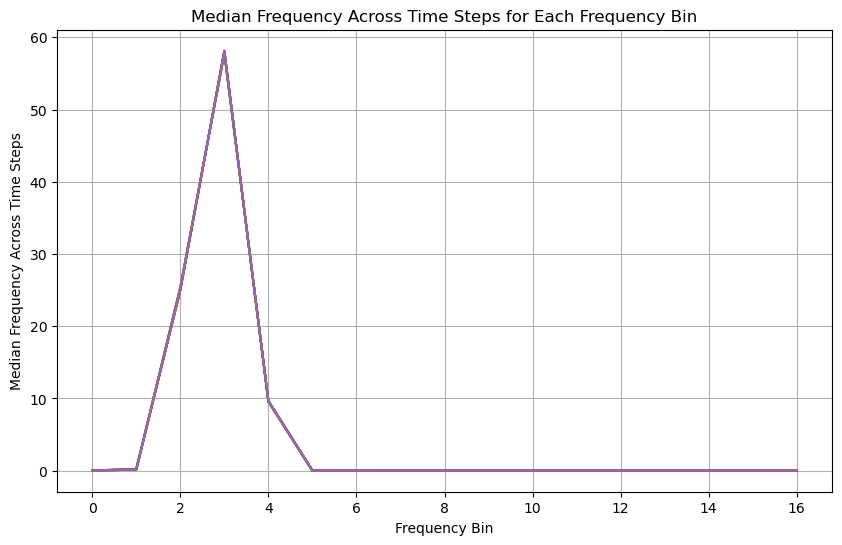

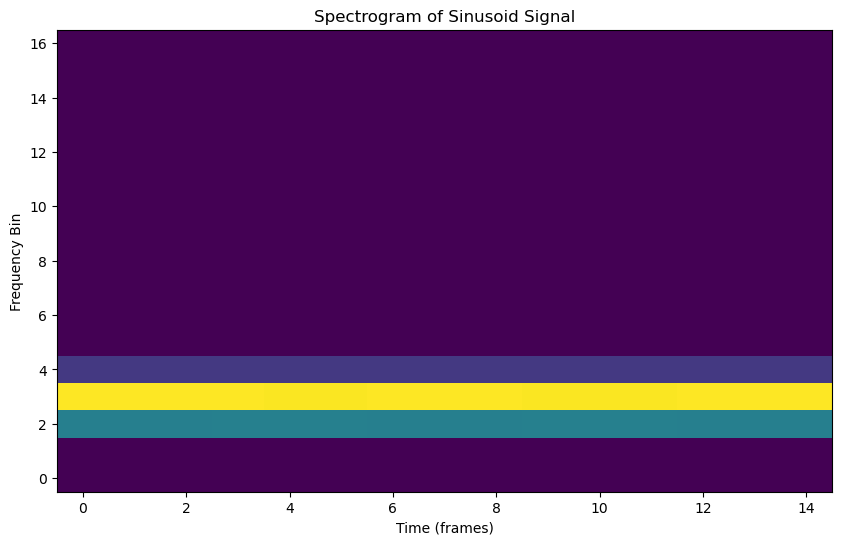

C:\Users\Dwang\anaconda3\Lib\site-packages\matplotlib\cbook\__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


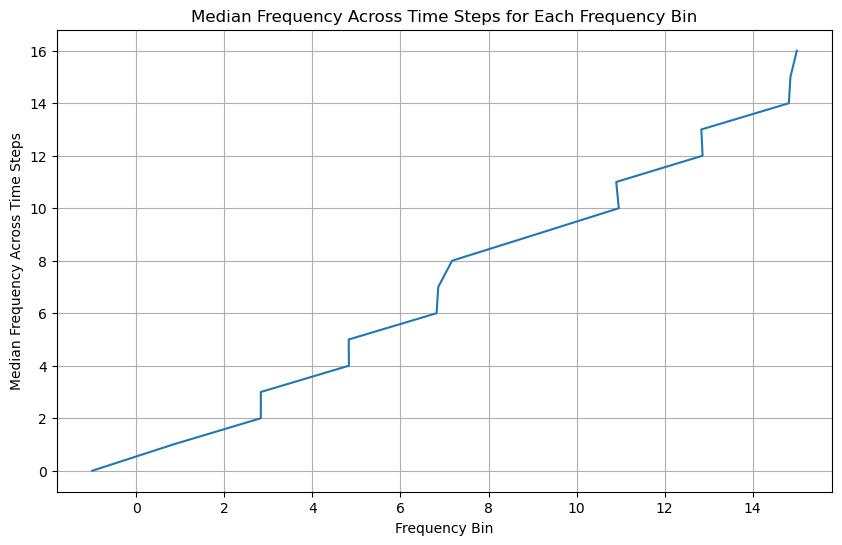

In [11]:
def exactFrequency(STFT_signal, w, h):
    instFreqArr = np.zeros_like(STFT_signal)
    for m in range(1, STFT_signal.shape[1]):  # Iterate over time frames
        for k in range(STFT_signal.shape[0]):  # Iterate over frequency bins
            # Compute backward differences of phase
            phase_diff = (np.angle(STFT_signal[k, m]) - np.angle(STFT_signal[k, m - 1])) - (2 * np.pi * h * k / w)
            # Wrap phase difference
            phase_diff_wrapped = (phase_diff + np.pi) % (2 * np.pi) - np.pi
            # Compute instantaneous frequency
            instFreqArr[k, m] = phase_diff_wrapped / (2 * np.pi / w *h) + (k)
    return instFreqArr

# Compute STFT and exact frequency
L = 256 
freq = np.sqrt(2) * np.pi / 8  
n = np.arange(L)
sin_wave = np.sin(freq * n)
STFT_signal = STFT(sin_wave, np.hanning(32), 16)
exact_freq = exactFrequency(STFT_signal, 32, 16);

# Compute median value across time steps for each frequency bin
median_freq_across_time = np.median(exact_freq[:, 1:], axis=1)  # Exclude the first time step

# Plot median frequency values across time steps
plt.figure(figsize=(10, 6))
#plt.plot(median_freq_across_time, range(len(median_freq_across_time)))
plt.plot(np.abs(STFT_signal)**2)
plt.xlabel('Frequency Bin')
plt.ylabel('Median Frequency Across Time Steps')
plt.title('Median Frequency Across Time Steps for Each Frequency Bin')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
#plt.imshow(np.abs(STFT_signal)**2, aspect='auto', origin='lower', cmap='viridis')
plt.imshow(np.abs(STFT_signal)**2, aspect='auto', origin='lower', cmap='viridis')
#plt.colorbar(label='Squared Magnitude')

plt.title('Spectrogram of Sinusoid Signal')
plt.xlabel('Time (frames)')
plt.ylabel('Frequency Bin')
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(median_freq_across_time, range(len(median_freq_across_time)))
#plt.plot(exact_freq)
plt.xlabel('Frequency Bin')
plt.ylabel('Median Frequency Across Time Steps')
plt.title('Median Frequency Across Time Steps for Each Frequency Bin')
plt.grid(True)
plt.show()

# Question 5:

Write a Python function to perform pitch scaling. Test your algorithm on both the voice
and piano audio with pitch scale factors of 2.0 and 0.5. Use 2048 Hann windows for both
STFT and OLA and hops of 512. (Not required, but feel free to experiment with different
windows, hops, and scale factors. If you want to play with transposing the key in which the
piano piece is played, use a scale factor of $2^{k/12}$ , where the integer k represents the number of
half-notes up (positive) or down (negative) from the original key. For example, to change the
key to a higher C minor, set k = 3, for a lower G minor, set k = −2.)


In [78]:
def pitch_scaling(STFT, original_file, scale_factor, window, hop_size):
    instFreqArray = exactFrequency(STFT, window, hop_size)
    scaled_freqs = instFreqArray * scale_factor
        
    window = int(window * scale_factor)
    new_bins_size = np.round(scale_factor * scaled_freqs.shape[0]).astype(int)
    print(new_bins_size)
    new_phase = np.zeros((new_bins_size, scaled_freqs.shape[1]))
    for m in range(new_phase.shape[1]):  # Iterate over time frames
        for k in range(new_phase.shape[0]):  # Iterate over frequency bins
            new_phase[k,m] = 2 * np.pi / window * hop_size * (scaled_freqs[int(np.round(k/new_bins_size)), m] - new_bins_size)
    for m in range(1, new_phase.shape[1]):  # Iterate over time frames
        for k in range(new_phase.shape[0]):  # Iterate over frequency bins
            # Compute backward differences of phase
            phase_diff = new_phase[k, m-1] + new_phase[k, m] + new_phase[k,m] + (2*np.pi/window *k*hop_size)
            # Wrap phase difference
            phase_diff_wrapped = (phase_diff + np.pi) % (2 * np.pi) - np.pi
            new_phase[k,m] = phase_diff_wrapped
            
    Y = np.zeros_like(new_phase)
    #print(Y.shape)
    # Step 7: Synthesize output signal
    for m in range(new_phase.shape[1]):  # Iterate over time frames
        for k in range(new_phase.shape[0]):  # Iterate over frequency bins
            Y[k,m] = np.abs(STFT[int(np.round(k/new_bins_size)),m])*np.exp(1j * new_phase[k,m])
            
    scaled_audio = OLA(Y, hannWindow(original_file,window), hop_size)

    return scaled_audio
STFT_signal = STFT(piano_signal, np.hanning(2048), 512)
scaled_audio = pitch_scaling(STFT_signal, piano_file, 0.5, 2044, 512)
Audio(data = scaled_audio, rate = framerateVoice)

512


C:\Users\Dwang\AppData\Local\Temp\ipykernel_2520\936712016.py:11: ComplexWarning: Casting complex values to real discards the imaginary part
  new_phase[k,m] = 2 * np.pi / window * hop_size * (scaled_freqs[int(np.round(k/new_bins_size)), m] - new_bins_size)
C:\Users\Dwang\AppData\Local\Temp\ipykernel_2520\936712016.py:25: ComplexWarning: Casting complex values to real discards the imaginary part
  Y[k,m] = np.abs(STFT[int(np.round(k/new_bins_size)),m])*np.exp(1j * new_phase[k,m])


(512, 1548)
(1022,)


# Question 6:

Use your pitch scaling function from the last part to change the speed of the two audio signals,
while keeping the original pitch intact. Do this by scaling the pitch and also appropriately
changing the sampling rate when playing back the audio. (Hint: Try doubling the sample
rate when playing back the audio. What happens to the pitch? Now think about how you
need to scale the frequency to return to the original pitch, but keeping the playback speed at
double the rate.) Try speeds of 0.5, 0.75, 1.5, and 2.0 times the original.

In [86]:
scaleFactors = [0.5, 0.75, 1.5, 2.0]

# Scale the pitch
scaled_bach_signal = pitch_scaling(STFT(piano_signal, np.hanning(512), 2),2, hannWindow(piano_signal, 2048), 512, 512)
    
adjusted_bach_framerate = piano_framerate * scaleFactors[0]
    
resampled_bach_signal = resample(scaled_bach_signal, piano_framerate, adjusted_bach_framerate)
output_signal = OLA(resampled_bach_signal, hannWindow(bach_signal, 2048), 512)
Audio(data=output_signal, rate=int(adjusted_bach_framerate))

KeyboardInterrupt: 

In [ ]:
adjusted_bach_framerate = piano_framerate * scaleFactors[0]
    
resampled_bach_signal = resample(scaled_bach_signal, piano_framerate, adjusted_bach_framerate)
output_signal = OLA(resampled_bach_signal, hannWindow(bach_signal, 2048), 512)
Audio(data=output_signal, rate=int(adjusted_bach_framerate))

In [ ]:
adjusted_bach_framerate = piano_framerate * scaleFactors[0]
    
resampled_bach_signal = resample(scaled_bach_signal, piano_framerate, adjusted_bach_framerate)
output_signal = OLA(resampled_bach_signal, hannWindow(bach_signal, 2048), 512)
Audio(data=output_signal, rate=int(adjusted_bach_framerate))

In [ ]:
adjusted_bach_framerate = piano_framerate * scaleFactors[0]
    
resampled_bach_signal = resample(scaled_bach_signal, piano_framerate, adjusted_bach_framerate)
output_signal = OLA(resampled_bach_signal, hannWindow(bach_signal, 2048), 512)
Audio(data=output_signal, rate=int(adjusted_bach_framerate))

# Z Transform

# Question 7: 

In class, we have seen the right-sided exponential and the left-sided exponential LTI systems. Their impulse response functions are given by: 

Right-sided: $$h_R[n] = a^{n} \cdot u[n]$$

Left-sided: $$h_L[n] = -b^n \cdot u[-n-1]$$


where $a, b \in \mathbb{C}$ are constants, and $u[n]$ is the unit step function. Now consider an LTI system that is defined by the impulse response: 

$$h[n] = h_R[n] + h_L[n]$$.

## (a)

What is the transfer function, H(z), for this system?



$$
\begin{align}
h[n] &= h_R[n] + h_L[n] \\
h[n] &= a^{n} \cdot u[n] - b^n \cdot u[-n-1] + h_L[n] \\
H(z) &= \frac{z}{z - a} - \frac{z}{z - b} \\
\end{align}
$$

## (b) 

What are the poles and zeros of this system?



$$
\begin{align}
Zeros: && z &= 0 \\
Poles: && z &= a, b
\end{align}
$$

## (c)

What is the region of convergence (ROC) for this system? Hint: This will be a region
defined in terms of the magnitudes, |a|, |b|.


The region of convergence for this system is within the area bounded by both the right sided and left sided exponential LTI systems, where |z| must be greater than the intersection of |a| and |b|.
$|z| > |a| \cap |b|$


## (d) 

Is this a causal system? Why or why not?

The causality of an LTI system is dependent on whether or not its impulse response is right sided, where its region of convergence is represented by $|z| > r_R$. The unit step function, defined as $h[n] = h_R[n] + h_L[n]$, is non-causual because of the left-sided exponential $h_L[n]$ which contains the term $u[-n-1]$. Therefore, this LTI system is not causual.

## (e) 

For constant values a = 0.5 and b = 1.5, plot the magnitude of the frequency response.
What can you say about how this system would effect the frequencies of an input signal?

This system allows near-zero frequencies to pass, while filtering out frequencies of increasing distance from 0 approaching $\pi$ and $-\pi$.

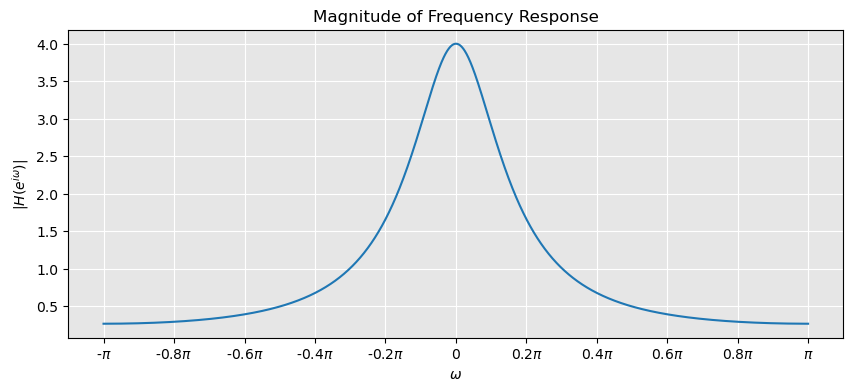

In [56]:
from scipy.io import wavfile
from scipy.signal import get_window, stft, istft
from scipy.signal import find_peaks
from matplotlib.ticker import FuncFormatter, MultipleLocator

def transfer_function(z):
    return (z / (z - 0.5)) - (z / (z - 1.5))
            
L = 2000
omega = np.arange(L) * 2.0 * np.pi / L - np.pi
H_z = transfer_function(np.exp(1j * omega))
            
ax = plt.figure(figsize=(10,4))
plt.plot(omega, np.abs(H_z))
ax = plt.gca()
ax.set_facecolor((0.9,0.9,0.9))
plt.grid(color = 'white')
plt.xlabel('$\\omega$')
plt.ylabel("$|H(e^{i\\omega})|$")
plt.title("Magnitude of Frequency Response")
ax.xaxis.set_major_formatter(FuncFormatter(
   lambda val,pos: '{:.1f}$\\pi$'.format(val/np.pi) if (val !=0 and val != np.pi and val != -np.pi) else '-$\\pi$' if val == -np.pi else '$\\pi$' if val == np.pi else '0'
))
ax.xaxis.set_major_locator(MultipleLocator(base=np.pi*0.2))

## Question 8
Consider the following transfer function:

$H(z) = ((z − 1)(z + 1)) / ((z − 0.5)(z + 0.5))$. 

(a) What are the poles and zeros of this system?

$$
\begin{align}
Poles: && z &= -0.5, 0.5  \\
Zeros: && z &= -1, 1
\end{align}
$$



(b) Write down an equation for this system as a linear constant-coefficient difference equation
(LCCDE). In other words, write an equation as a sum of time-shifted and scaled copies
of the input x[n] and the ouput y[n].

$$
\begin{align}
H(z) &= \frac{(z − 1)(z + 1)}{(z − 0.5)(z + 0.5)} = \frac{z^2 + z - z -1}{z^2 + 0.5z - 0.5z -0.25}, \\
H(z) &= \frac{z^2 - 1}{z^2 - 0.25} = \frac{1 - z^{-2}}{1 - 0.25z^{-2}} \\
\end{align}
$$

Inverse z-transform for Y(z) and X(z) 

$$
\begin{align}
h[n] &= \frac{y[n] - 0.25y[n - 2]}{  x[n] - x[n - 2]} \\
y[n] - 0.25y[n - 2] &= x[n] - x[n - 2] \\
y[n] &= 0.25y[n - 2] + x[n] - x[n - 2] \\
\end{align}
$$







(c) Again, plot the magnitude of the frequency response for this system. What can you say
about how this system would effect the frequencies of an input signal?

This LTI system has multiple zeros and poles, meaning that it allows more than one interval of frequencies pass depending on its pairings of pole-pairs. This is referred to as a band-limit for  discrete signal $y[n]$.

Value at x = 0.7853981633974483: 1.3719886811400708
Value at x = 0.39269908169872414: 0.9089979239536471
Value at x = 1.0471975511965976: 1.5114655895383884


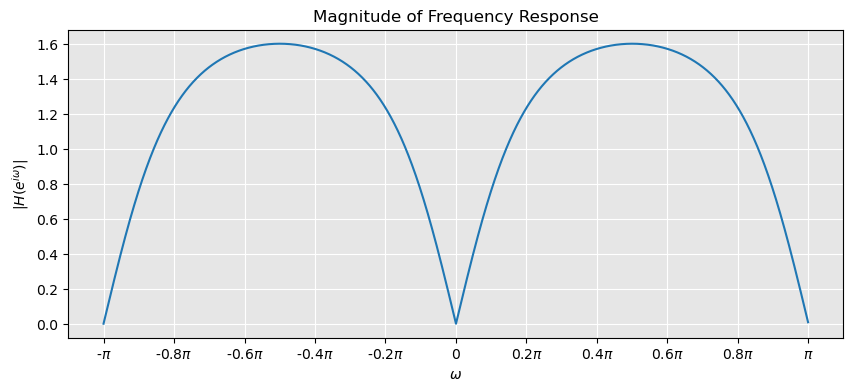

In [63]:
def transfer_function8(z):
    return ((z + 1) * (z - 1)) / ((z + 0.5) * (z - 0.5))
L = 2000
omega = np.arange(L) * 2.0 * np.pi / L - np.pi
H_z= transfer_function8(np.exp(1j * omega))

ax = plt.figure(figsize=(10,4))
plt.plot(omega, np.abs(H_z))
ax = plt.gca()
ax.set_facecolor((0.9,0.9,0.9))
plt.grid(color = 'white')
plt.xlabel('$\\omega$')
plt.ylabel("$|H(e^{i\\omega})|$")
plt.title("Magnitude of Frequency Response")
ax.xaxis.set_major_formatter(FuncFormatter(
   lambda val,pos: '{:.1f}$\\pi$'.format(val/np.pi) if (val !=0 and val != np.pi and val != -np.pi) else '-$\\pi$' if val == -np.pi else '$\\pi$' if val == np.pi else '0'
))
ax.xaxis.set_major_locator(MultipleLocator(base=np.pi*0.2))

# Printing values at specified axis points
x_values = [np.pi/4, np.pi/8, np.pi/3]
for x_value in x_values:
    idx = np.abs(omega - x_value).argmin()
    y_value = np.abs(H_z[idx])
    print(f"Value at x = {x_value}: {y_value}")

(d) Write a Python function to implement your system equation in part (b). Test it on
real-valued sinusoid signals, x[n] = sin(ωn), for angular frequencies of ω =
π /
8
, ω =
π /
4
,
and ω =
π /
3
. Verify that you get sinusoids as output. Using the frequency response
function, H(e
iω), what is the expected change in magnitude (amplitude) and phase of
these sinusoids? Again, verify that your system produced these amplitude and phase
changes.

Indices of peaks: [ 2 18 34 50 66]
Values of peaks: [0.707 0.894 0.894 0.894 0.894]


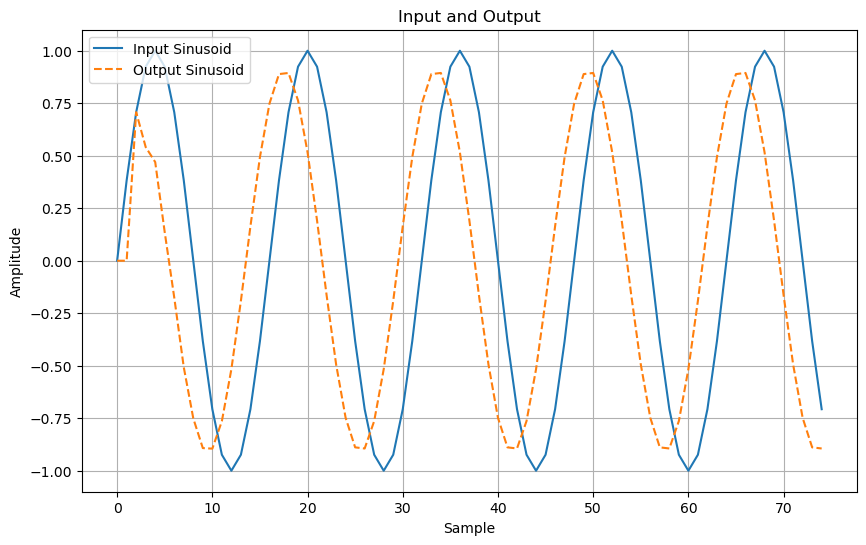

In [75]:
def system_equation(x):
    y = np.zeros(len(x), dtype=float)
    for n in range(2, L): 
        y[n] = 0.25 * y[n - 2] + x[n] - x[n - 2]
    return y

L = 75
amplitude = 1
frequency = np.pi/8 

x_signal = amplitude * np.sin(frequency * np.arange(L))
y_signal = system_equation(x_signal)
peaks, _ = find_peaks(y_signal)
rounded_peak_values = np.round(y_signal[peaks], 3)
print("Indices of peaks:", peaks)
print("Values of peaks:", rounded_peak_values)

plt.figure(figsize=(10, 6))
plt.plot(x_signal, label='Input Sinusoid')
plt.plot(y_signal, linestyle='--', label='Output Sinusoid')
plt.title('Input and Output')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.legend()
plt.grid(True)
plt.show()


Indices of peaks: [ 2  9 17 25 33 41 49 57 65 73]
Values of peaks: [1.    1.326 1.331 1.331 1.331 1.331 1.331 1.331 1.331 1.331]


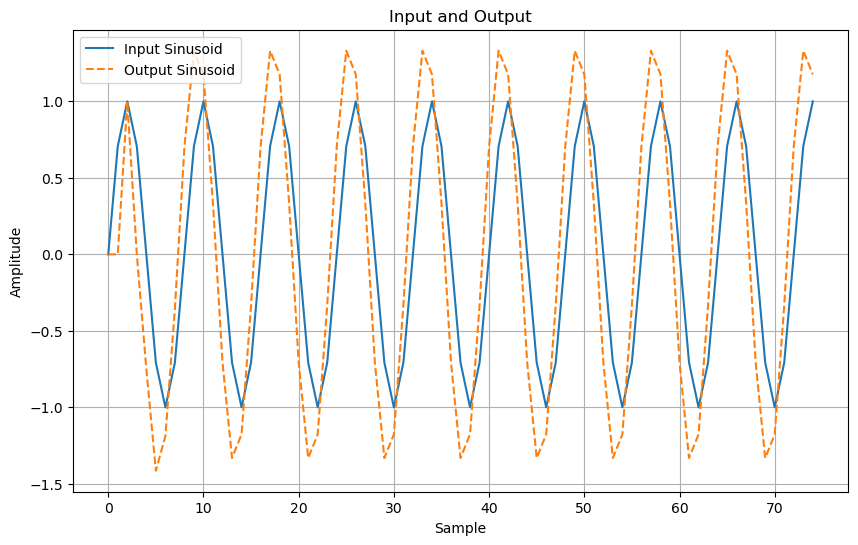

In [74]:
frequency = np.pi/4  
phase_shift = 0

x_signal = amplitude * np.sin(frequency * np.arange(L))
y_signal = system_equation(x_signal)
peaks, _ = find_peaks(y_signal)
rounded_peak_values = np.round(y_signal[peaks], 3)
print("Indices of peaks:", peaks)
print("Values of peaks:", rounded_peak_values)

plt.figure(figsize=(10, 6))
plt.plot(x_signal, label='Input Sinusoid')
plt.plot(y_signal, linestyle='--', label='Output Sinusoid')
plt.title('Input and Output')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.legend()
plt.grid(True)
plt.show()


Indices of peaks: [ 2  7 13 19 25 31 37 43 49 55 61 67 73]
Values of peaks: [0.866 1.461 1.484 1.485 1.485 1.485 1.485 1.485 1.485 1.485 1.485 1.485
 1.485]


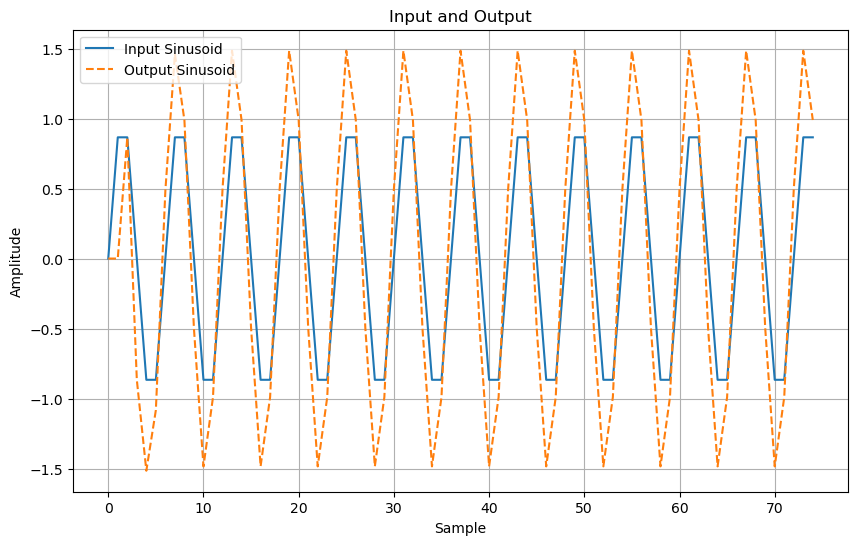

In [73]:
frequency = np.pi/3  
phase_shift = 0

x_signal = amplitude * np.sin(frequency * np.arange(L))
y_signal = system_equation(x_signal)
peaks, _ = find_peaks(y_signal)
rounded_peak_values = np.round(y_signal[peaks], 3)
print("Indices of peaks:", peaks)
print("Values of peaks:", rounded_peak_values)

plt.figure(figsize=(10, 6))
plt.plot(x_signal, label='Input Sinusoid')
plt.plot(y_signal, linestyle='--', label='Output Sinusoid')
plt.title('Input and Output')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.legend()
plt.grid(True)
plt.show()


## Question 9 
An LTI system is given input signal:
$x[n] = \frac{1}{2} ^ n
u[n] + 2^nu[−n − 1].$
The corresponding output is:
$y[n] = 6 *
\frac{1}{2}^{n} *u[n] − 6 *\frac{3}{4}^{n}
u[n].$

(a) What is the transfer function, H(z), for this system?

$$
H(z) = \frac{Y(z)}{X(z)} \\
H(z) = \frac{-12 * (z-2)}{(4z-3)(4z-5)}
$$

(b) Plot the poles and zeros of the system.

Zeros are at z = 2, poles are at z=$\frac{3}{4}$ and $\frac{5}{4}$

(c) What is the region of convergence (ROC) for this system?

The region of convergence is located between the two poles. In this case, the ROC would be between 3/4 and 5/4 such that $|z| > \frac{3}{4}, |z| > \frac{5}{4}$

(d) Is this system causal?

No, the input signal contains the term $u[−n − 1]$ which looks forward in time, and therefore the system is not causual.

(e) Is it stable?

Yes, because the ROC is right side and contains the unit circle within its bounds as represented by its two poles.